# Object detection practice

This is like It says in the title an object detection demo, that I have done to learn how it works and see the results from a pre trained model.

# Libraries Imported

As you can see in the next cell of code we have the libraries I consider necessary to get this task done.However, I avoid some libraries that the simple demo which is given by Tensorflow uses,instead I start reading images with cv2, one of the libraries I have worked to deal with images' data.

In [ ]:
import tensorflow as tf

import tensorflow_hub as hub

# For downloading the image.
import matplotlib.pyplot as plt
import tempfile
from six import BytesIO

# For drawing onto the image.
import numpy as np
from PIL import Image
from PIL import ImageColor
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageOps
import os
import time
import cv2
import glob
import gdown

# Test Data

I had some pictures of flowers, so I decided to start working with some of them just to get a quick result.By the way, this photos has been downloaded from my google drive.

In [ ]:


zip_path_test = '/content/test.zip'  #  destination path
test_url = 'https://drive.google.com/uc?export=download&id=1pogfaMFdU-yzFCds_kj6sTwIEbVFxcP-' # the origin

# Donwload zip folder
gdown.download(test_url, zip_path_test, quiet=False)

Downloading...
From: https://drive.google.com/uc?export=download&id=1pogfaMFdU-yzFCds_kj6sTwIEbVFxcP-
To: /content/test.zip
100%|██████████| 49.3M/49.3M [00:00<00:00, 102MB/s]


'/content/test.zip'

In [ ]:
# Unzip folder
!unzip /content/test.zip

Archive:  /content/test.zip
  inflating: test/Image_1.jpg        
  inflating: test/Image_10.jpg       
  inflating: test/Image_100.jpg      
  inflating: test/Image_101.jpg      
  inflating: test/Image_102.jpg      
  inflating: test/Image_103.jpg      
  inflating: test/Image_104.jpg      
  inflating: test/Image_105.jpg      
  inflating: test/Image_106.jpg      
  inflating: test/Image_107.jpg      
  inflating: test/Image_108.jpg      
  inflating: test/Image_109.jpg      
  inflating: test/Image_11.jpg       
  inflating: test/Image_110.jpg      
  inflating: test/Image_111.jpg      
  inflating: test/Image_112.jpg      
  inflating: test/Image_113.jpg      
  inflating: test/Image_114.jpg      
  inflating: test/Image_115.jpg      
  inflating: test/Image_116.jpg      
  inflating: test/Image_117.jpg      
  inflating: test/Image_118.jpg      
  inflating: test/Image_119.jpg      
  inflating: test/Image_12.jpg       
  inflating: test/Image_120.jpg      
  inflating: test/Imag

The next 4 cells of code are provided by tensorflow because It's the way how in general you should read images,draw boxes into the image as well indicating the objects the model has found, display them, load the images by tensorflow methods and run the pre-trained model to begin to work.



In [ ]:
def download_and_resize_image(url, new_width=256, new_height=256,
                              display=False):
  cont = 0
  pics= []
  for imagen in glob.glob(url + '/*.*'):
      if cont == 10:
          break
      _, filename = tempfile.mkstemp(suffix=".jpg")
      pic = cv2.imread(imagen)
      pil_image = Image.fromarray(cv2.cvtColor(pic, cv2.COLOR_BGR2RGB))
      pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS)
      pil_image.save(filename, format="JPEG", quality=90)
      pics.append(filename)
      print("Image downloaded to %s." % filename)
      cont += 1
  return pics

In [ ]:
def display_image(image):
  fig = plt.figure(figsize=(20, 15))
  plt.grid(False)
  plt.imshow(image)

def draw_bounding_box_on_image(image,
                               ymin,
                               xmin,
                               ymax,
                               xmax,
                               color,
                               font,
                               thickness=4,
                               display_str_list=()):
  """Adds a bounding box to an image."""
  draw = ImageDraw.Draw(image)
  im_width, im_height = image.size
  (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                ymin * im_height, ymax * im_height)
  draw.line([(left, top), (left, bottom), (right, bottom), (right, top),
             (left, top)],
            width=thickness,
            fill=color)

  # If the total height of the display strings added to the top of the bounding
  # box exceeds the top of the image, stack the strings below the bounding box
  # instead of above.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
  # Each display_str has a top and bottom margin of 0.05x.
  total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)

  if top > total_display_str_height:
    text_bottom = top
  else:
    text_bottom = top + total_display_str_height
  # Reverse list and print from bottom to top.
  for display_str in display_str_list[::-1]:
    text_width, text_height = font.getsize(display_str)
    margin = np.ceil(0.05 * text_height)
    draw.rectangle([(left, text_bottom - text_height - 2 * margin),
                    (left + text_width, text_bottom)],
                   fill=color)
    draw.text((left + margin, text_bottom - text_height - margin),
              display_str,
              fill="black",
              font=font)
    text_bottom -= text_height - 2 * margin


def draw_boxes(image, boxes, class_names, scores, max_boxes=10, min_score=0.1):
  """Overlay labeled boxes on an image with formatted scores and label names."""
  colors = list(ImageColor.colormap.values())

  try:
    font = ImageFont.truetype("/usr/share/fonts/truetype/liberation/LiberationSansNarrow-Regular.ttf",
                              25)
  except IOError:
    print("Font not found, using default font.")
    font = ImageFont.load_default()

  for i in range(min(boxes.shape[0], max_boxes)):
    if scores[i] >= min_score:
      ymin, xmin, ymax, xmax = tuple(boxes[i])
      display_str = "{}: {}%".format(class_names[i].decode("ascii"),
                                     int(100 * scores[i]))
      color = colors[hash(class_names[i]) % len(colors)]
      image_pil = Image.fromarray(np.uint8(image)).convert("RGB")
      draw_bounding_box_on_image(
          image_pil,
          ymin,
          xmin,
          ymax,
          xmax,
          color,
          font,
          display_str_list=[display_str])
      np.copyto(image, np.array(image_pil))
  return image

In [ ]:
def load_img(path):
  img = tf.io.read_file(path)
  img = tf.image.decode_jpeg(img, channels=3)
  return img

In [ ]:
def run_detector(detector, path):
  img = load_img(path)

  converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
  start_time = time.time()
  result = detector(converted_img)
  end_time = time.time()

  result = {key:value.numpy() for key,value in result.items()}

  print("Found %d objects." % len(result["detection_scores"]))
  print("Inference time: ", end_time-start_time)

  image_with_boxes = draw_boxes(
      img.numpy(), result["detection_boxes"],
      result["detection_class_entities"], result["detection_scores"])

  display_image(image_with_boxes)

Here we just load the model from api.

In [ ]:
module_handle = "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1" #@param ["https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1", "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1"]

detector = hub.load(module_handle).signatures['default']

Donwload and resize all images from the folder and create another path for them.

In [ ]:
img = download_and_resize_image('/content/test',1000,800) # size 1000x800

Image downloaded to /tmp/tmp7egscl_i.jpg.
Image downloaded to /tmp/tmpziqcuevz.jpg.
Image downloaded to /tmp/tmpbdsna204.jpg.
Image downloaded to /tmp/tmpcjcsjvco.jpg.
Image downloaded to /tmp/tmp1l44tk8v.jpg.
Image downloaded to /tmp/tmpanl6c30y.jpg.
Image downloaded to /tmp/tmpzkc4883r.jpg.
Image downloaded to /tmp/tmp_a1s6qhe.jpg.
Image downloaded to /tmp/tmpu7f8hc5_.jpg.
Image downloaded to /tmp/tmp9bgszd7g.jpg.


Finally we run the detector and see the results from 10 first images.

Found 100 objects.
Inference time:  83.2484757900238
Found 100 objects.
Inference time:  38.421292781829834
Found 100 objects.
Inference time:  35.66037321090698
Found 100 objects.
Inference time:  32.51690149307251
Found 100 objects.
Inference time:  32.31807279586792
Found 100 objects.
Inference time:  32.85349631309509
Found 100 objects.
Inference time:  32.57475471496582
Found 100 objects.
Inference time:  33.576743602752686
Found 100 objects.
Inference time:  33.39258122444153
Found 100 objects.
Inference time:  32.49536371231079


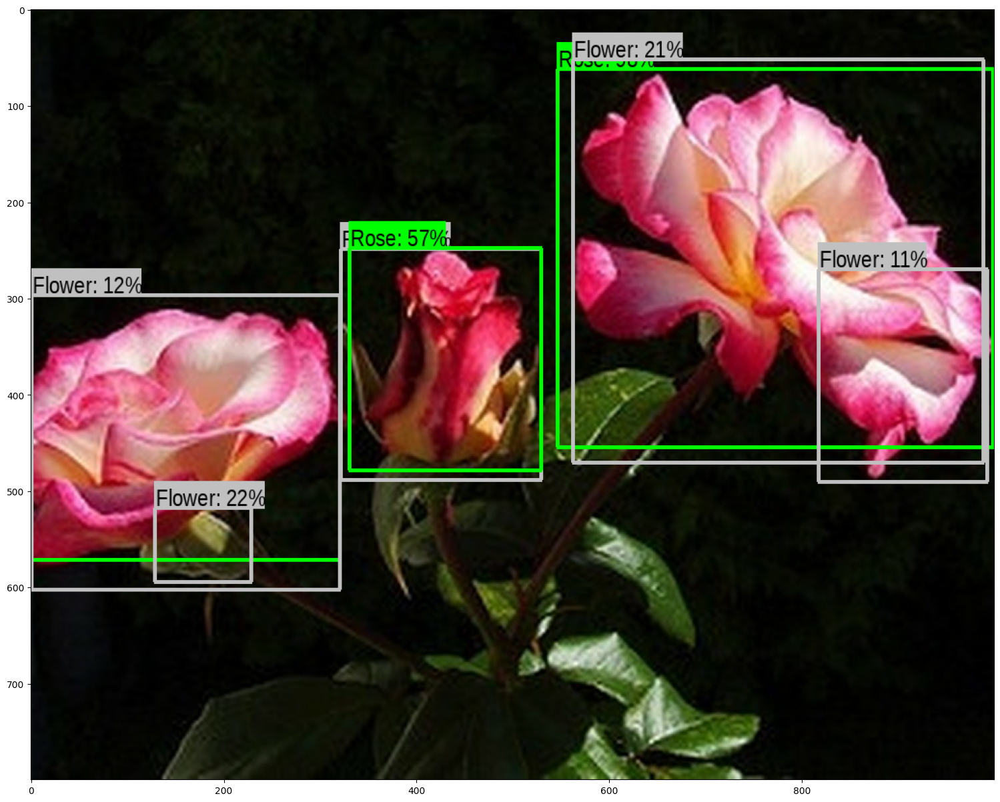

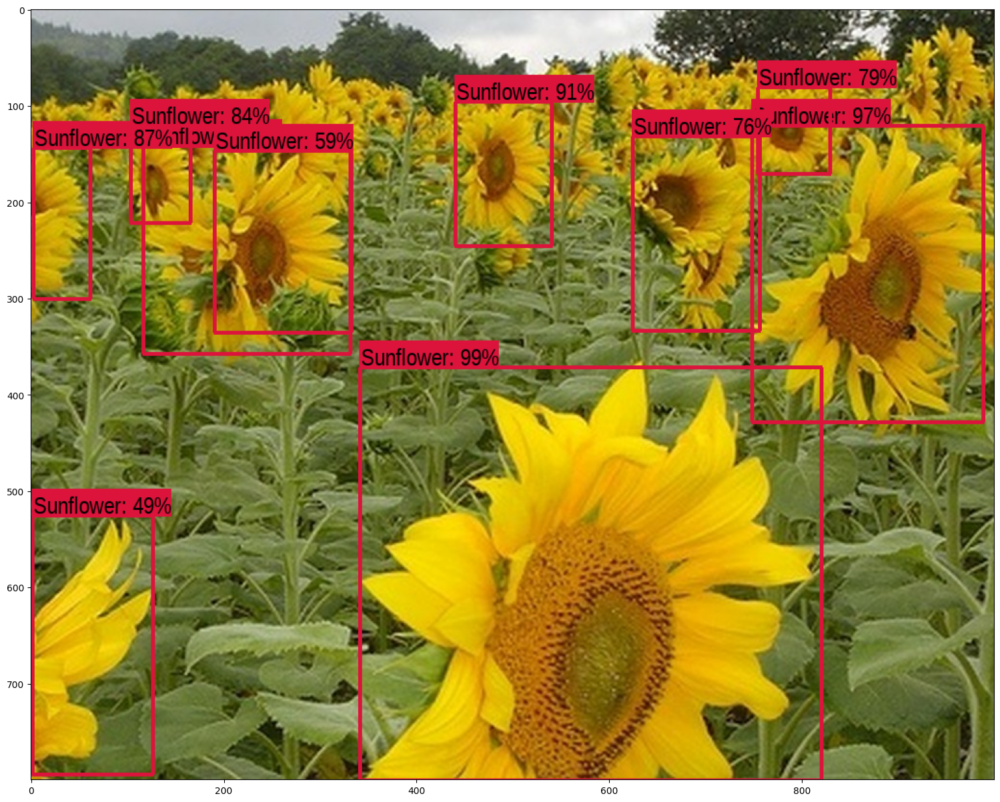

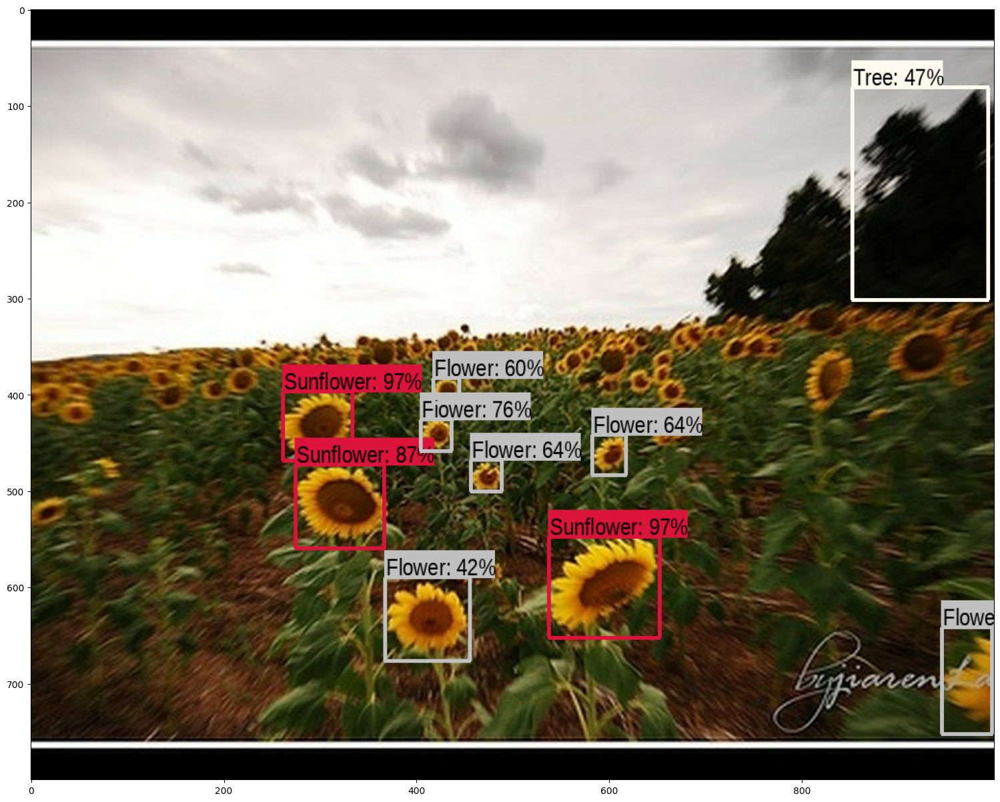

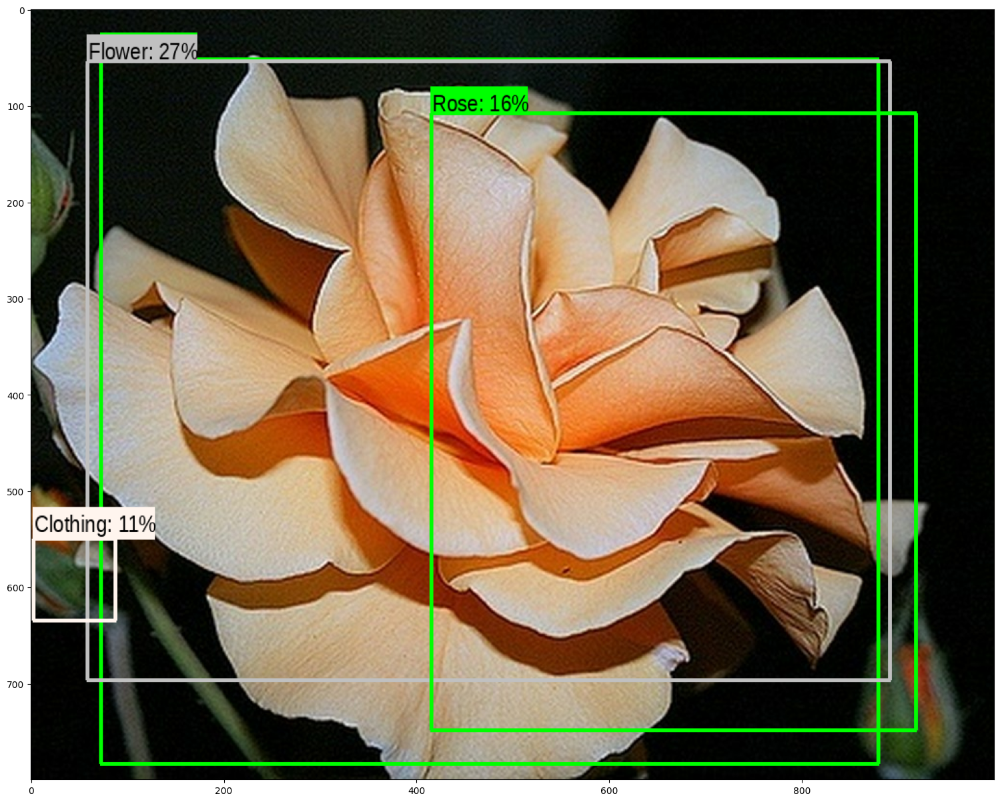

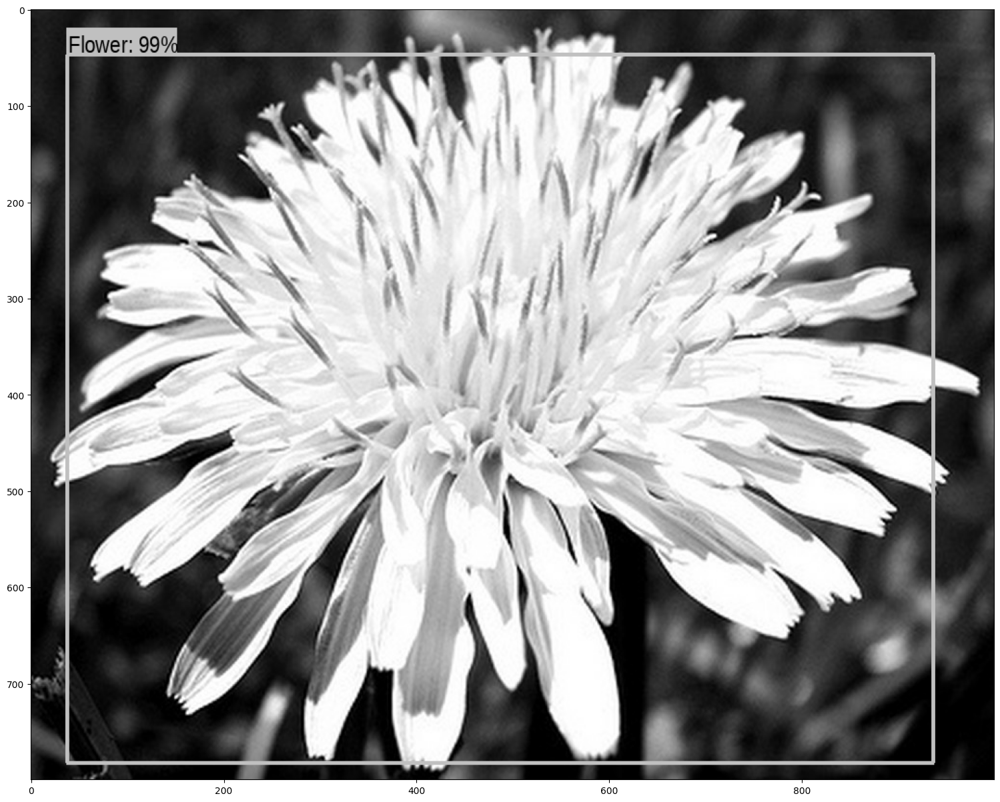

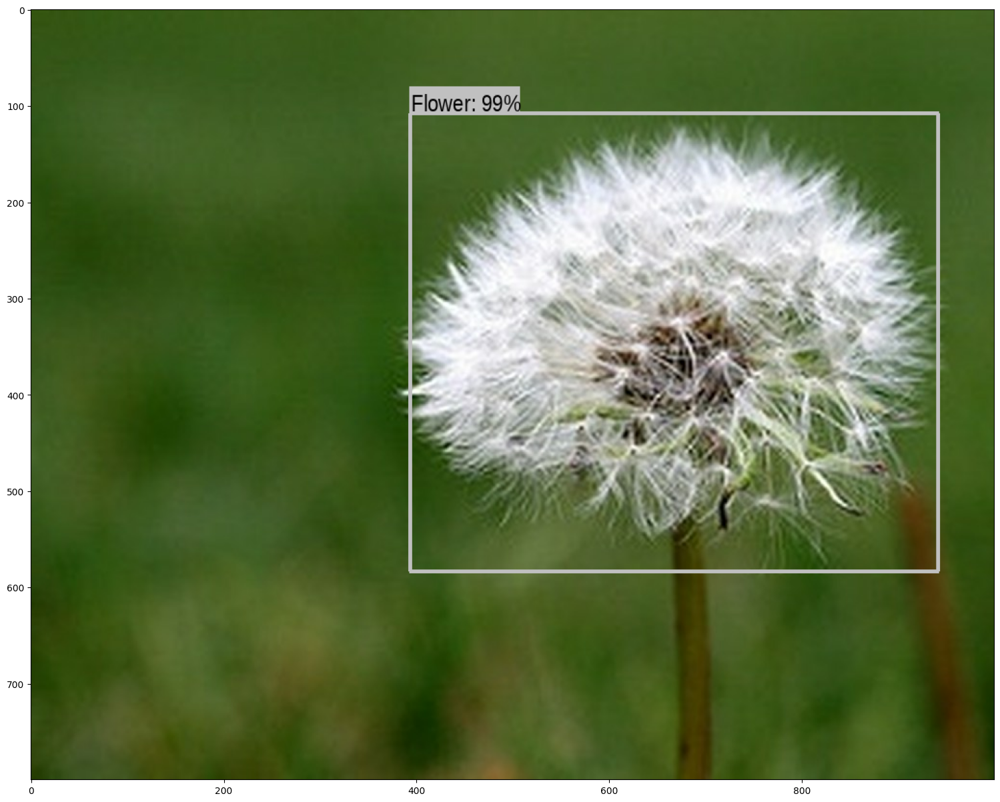

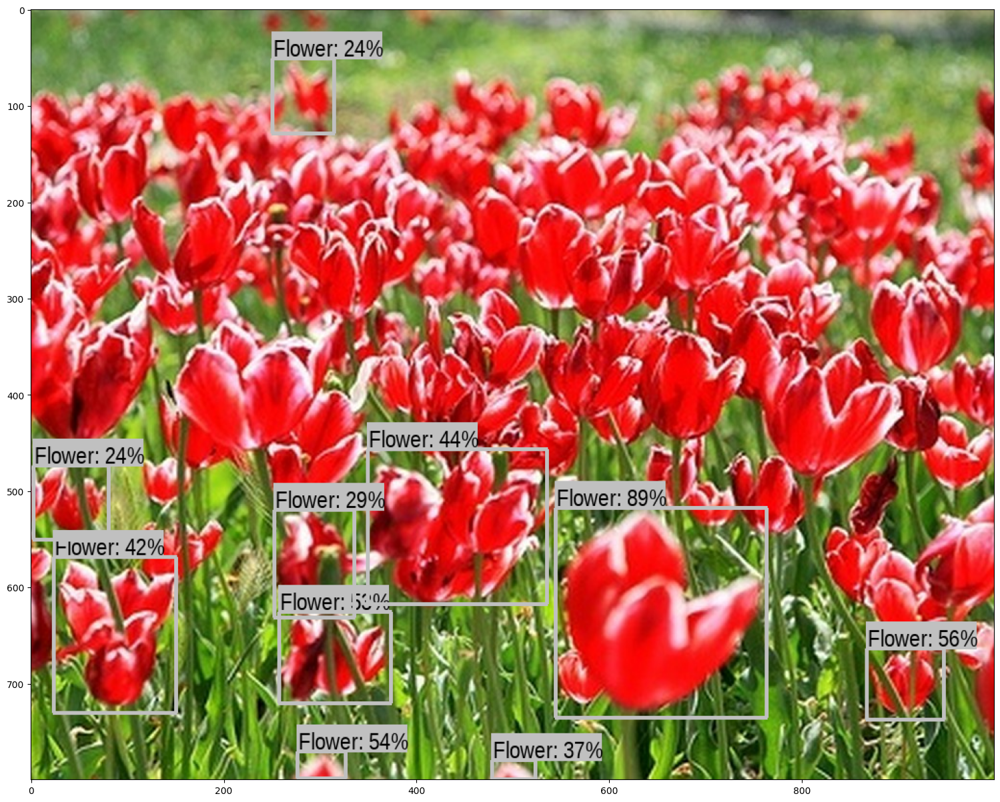

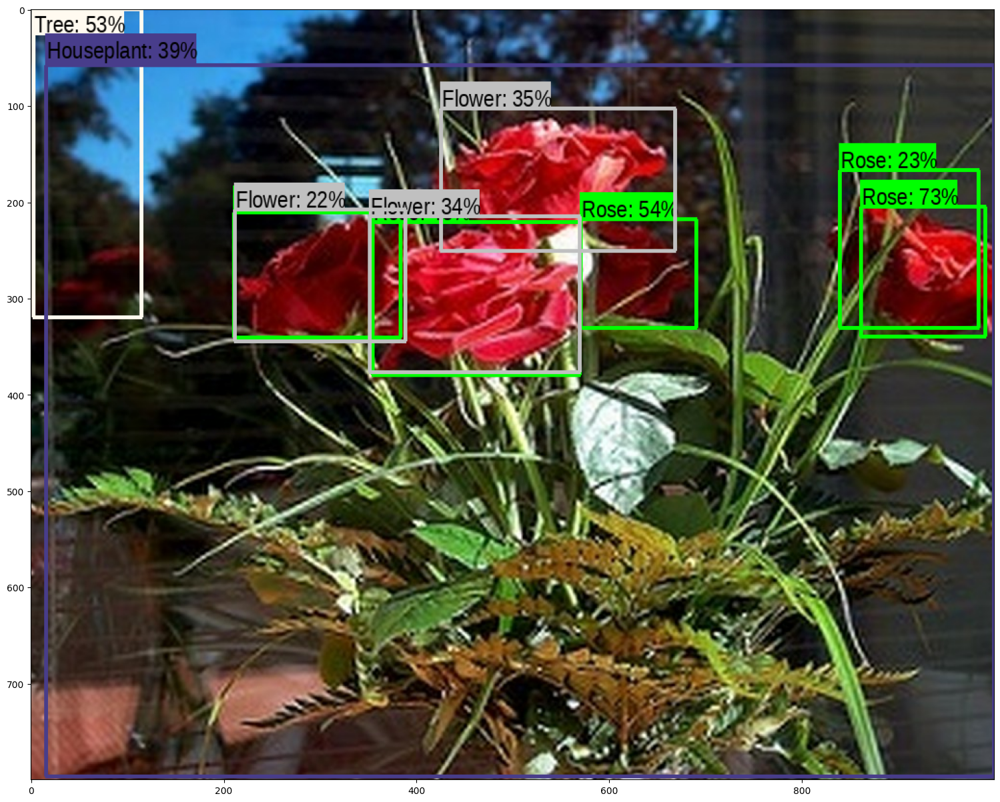

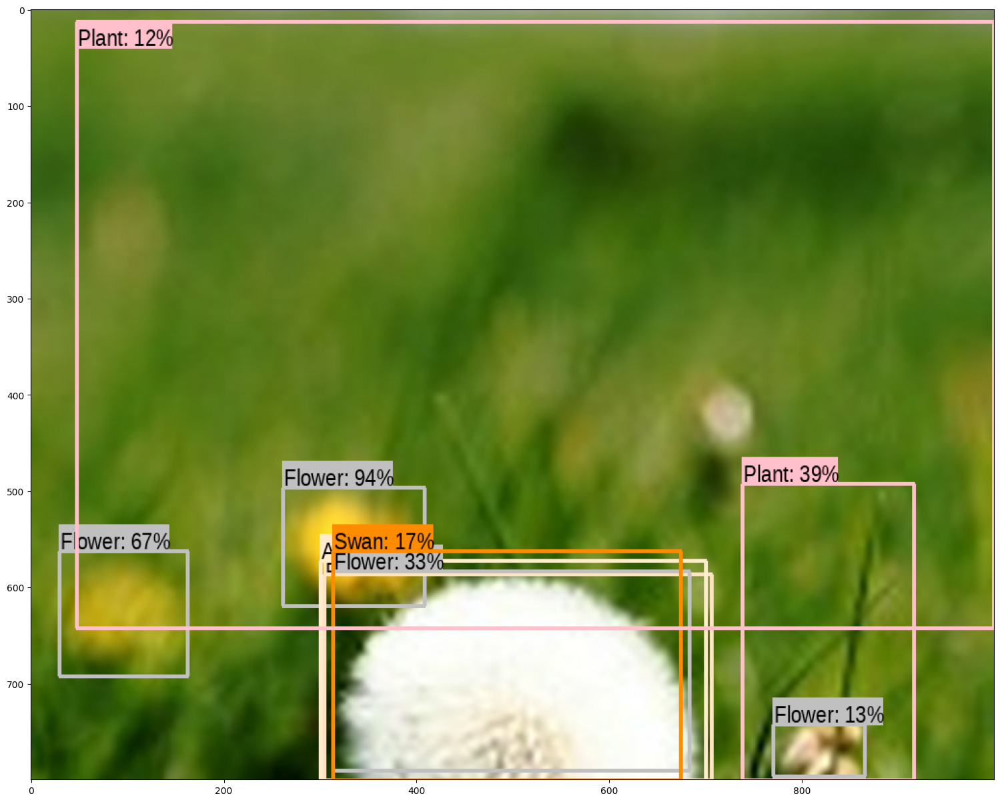

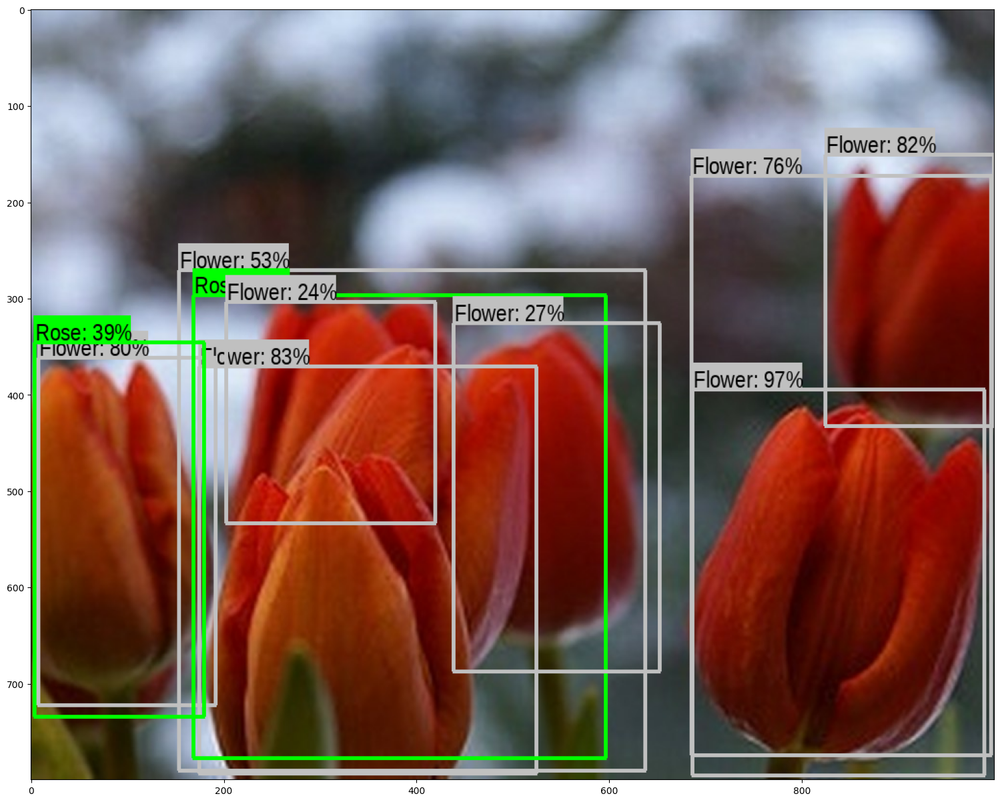

In [ ]:
for i in img:
  run_detector(detector,i)